In [4124]:
doc_index = 53
doc = index_doc[doc_index]
print dict_labels_english[doc]

12th-A - Magnetic fields and transformers 


# Discourse analysis in a physic session

In this document is presented an analysis of the teacher discourse in a physic session. To analyze the teacher discourse we use a topic model to understand the relations between different concepts. We measure the intensity of the co-occurrence of topics during the session.


The analysis is divided in two parts:
- 1) an aggregated analysis: here we group discourse topics and show the intensity of the co-occurrence of these groups.
- 2) a disaggregated analysis: here we show the co-occurrance intensity of the main topics

### 1- Import

In [4060]:
# -*- coding: utf-8 -*-
%matplotlib inline
import os
from ena import text_preprocessing as tp, ena_processing as ep, ena_viz as ev
import numpy as np
from nltk.corpus import stopwords
import matplotlib
import matplotlib.pyplot as plt, mpld3
mpld3.enable_notebook()
import matplotlib.pylab as pylab
import pickle
import pandas as pd
from scipy.fftpack import fft, fftfreq, fftshift

In [4061]:
import plotly
plotly.tools.set_credentials_file(username='catta.ugs', api_key='BGbZD5URMqON8tOnEmcK')
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as offline

### paths

In [4062]:
root_path = os.path.join('..','..','..')
data_path = os.path.join(root_path,'data')
output_path = os.path.join(root_path,'output')
pickle_path = os.path.join(output_path,'pickles')
by_grade_path = os.path.join(output_path,'textos_ulloa_by_curso')
by_grade_and_content = os.path.join(data_path,'textos_ulloa_by_grade_content')
by_content_path = os.path.join(output_path,'textos_ulloa_by_contenido')
all_files_path = os.path.join(data_path,'textos_ulloa')
all_classes = os.path.join(data_path,'clases_ulloa.txt')

In [4063]:
FILTER_BY_LENGTH = True
MIN_LENGTH = 20 # minutes

COPY_WITH_LOSS = False
LOST_WORDS = 10 # percentage

SPLIT_DOCUMENTS_IN_PERIODS = True
PERIOD_LENGTH = 5 # minutss
OVERLAP_LENGTH = 4 # minutes

USE_DIAGONAL = False

### Get sesions and info related

In [4064]:
all_documents_dict = tp.read_documents(all_files_path)
with open(os.path.join(output_path,'pickles','document_length_dict.pickle'),'rb') as f:
    document_length = pickle.load(f)

In [4065]:
if FILTER_BY_LENGTH:
    filtered_documents = tp.filter_by_duration(document_length,all_documents_dict,MIN_LENGTH)
else:
    filtered_documents = all_documents_dict

In [4066]:
with open(os.path.join(output_path,'pickles','label_per_audio.pickle'),'rb') as f:
    labels_per_audio = pickle.load(f)

In [4067]:
labels_english = pd.read_csv(os.path.join(data_path,'labels_english.csv'),sep=';')
dict_labels_english = {}
for i,k in enumerate(labels_english.key_doc):
    dict_labels_english[str(k)] = labels_english.label_english.values[i]

In [4068]:
axes_text = ['Content - Science Skills','Content - Math Skills','Science skills - Math skills']
axes_colors = ['#2fd32f','#D32F2F','#2f2fd3']

In [4069]:
levels = [[] for i in range(6)]
counter = 0
for k,v in labels_per_audio.items():
    for i in range(6):
        if k in filtered_documents.keys():
            if v.startswith(str(7+i)):
                levels[i].append(k)
                counter +=1
        levels[i].sort()
        #levels[i] = list()
index_doc = []
for l in levels:
    for l_i in l:
        index_doc.append(l_i)
print len(index_doc)

54


In [4070]:
with open(os.path.join(pickle_path,str(PERIOD_LENGTH)+'_minutes_'+str(OVERLAP_LENGTH)+'_splitted_stuff.pickle'),'rb') as f:
    splitted_documents = pickle.load(f)
    splitted_labels = pickle.load(f)
    splitted_by_session = pickle.load(f)
    labels_by_session = pickle.load(f)

In [4071]:
with open(os.path.join(pickle_path,'super_vectors_'+str(PERIOD_LENGTH)+'_minutes_'+str(OVERLAP_LENGTH)+'overlap_30s_windows_norm_by_stanza.pickle'),'rb') as f:
    super_matrices = pickle.load(f)
    super_vectors = pickle.load(f)
    a_d = pickle.load(f)

In [4072]:
with open(os.path.join(pickle_path,'co_occurrence_matrices'+str(PERIOD_LENGTH)+'_minutes_'+str(OVERLAP_LENGTH)+'overlap_complete_sample.pickle'),'rb') as f:
    co_ocurrence_matrices = pickle.load(f)
    labels_array_matrices = pickle.load(f)
    co_ocurrence_matrices_all_corpus = pickle.load(f)
    labels_corpus = pickle.load(f)

In [4073]:
norm_matrices_corpus = {}
for key in co_ocurrence_matrices_all_corpus.keys():
    norm_matrices_corpus[key] = co_ocurrence_matrices_all_corpus[key]*12.0/a_d[key]

In [4074]:
norm_matrices = {}
for key in co_ocurrence_matrices.keys():
    norm_matrices[key] = co_ocurrence_matrices[key]*12.0/ep.get_n_stanzas_by_doc(PERIOD_LENGTH*60/5,6,1)

In [4075]:
with open(os.path.join(pickle_path,'clean_topics_english.pickle'),'rb') as f:
    topic_names = pickle.load(f)
    topic_score = pickle.load(f)
    topic_words = pickle.load(f)
with open(os.path.join(pickle_path,'topics_heber_sessions.pickle'),'rb') as f:
    dict_words_topics_index = pickle.load(f)
    topic_vectors = pickle.load(f)
    sorted_index = pickle.load(f)
selected_topics = map(lambda x: topic_names[x],sorted_index[-16:]) # top 16 topics
selected_t_words = map(lambda x: topic_words[x],sorted_index[-16:]) # top 16 topics
selected_t_scores = map(lambda x: topic_score[x],sorted_index[-16:]) # top 16 topics
selected_t_scores = map(lambda l: map(lambda x: float(x.replace('.','').replace(',','.')),l),selected_t_scores)
content_topics = [0,15,3,6,13,10,4,7]
science_skills_topics = [1,12,5,9]
science_tools_topics = [2,8,11,14]
groups_of_topics = [content_topics,science_skills_topics,science_tools_topics]

#### Agrupar chunks por sesion

In [4076]:
super_vectors_corpus_splitted = {}
for doc in labels_by_session.keys():
    x_3d = []
    y_3d = []
    z_3d = []
    for i in range(len(labels_by_session[doc].keys())):
        # construir label_i
        label_i = doc+'_period_'+str(i)
        x_3d.append(round(super_vectors[label_i][0],2)*12)
        y_3d.append(round(super_vectors[label_i][1],2)*12)
        z_3d.append(round(super_vectors[label_i][2],2)*12) 
    super_vectors_corpus_splitted[doc] = {'c-s':np.array(x_3d),'c-m':np.array(y_3d),'s-m':np.array(z_3d)}

In [4077]:
selected_topics[4] = 'Electric circuits'

### Select doc

In [4078]:
doc = index_doc[doc_index]

In [4079]:
np.array(selected_topics)[science_tools_topics]

array(['Time units', 'Compute', 'Numbers', 'Order'], dtype='|S17')

## Aggregated topic analysis

In this part the topics are grouped in three Super groups:

- Content topics (physic contents): 
       'Kinematics', 'Dynamics', 'Gas laws', 'Solar system',
       'Water resources', 'Forms of energy', 'Electric circuits',
       'Electrostatics'
- Science skills:
        'Observe', 'Enquire', 'Explain', 'Excercise'
- Math skills:
        'Time units', 'Compute', 'Numbers', 'Order'

### Trayectory of a session (bluest dot is the beginning, redest dot is the ending)

In [4080]:
trace_dummy = go.Scatter3d(
                x= [0,6],
                y=[0,6],
                z = [0,6],
                line = dict(color = axes_colors[0]),
                opacity = 0.0,
                showlegend=False)

In [4081]:
x_3d = []
y_3d = []
z_3d = []
las_labels = []
for i in range(len(labels_by_session[doc].keys())):
    # construir label_i
    label_i = doc+'_period_'+str(i)
    #value_i = labels_array_matrices.index(label_i)
    a_label = splitted_labels[label_i]
    x_3d.append(round(super_vectors[label_i][2],2)*12)
    y_3d.append(round(super_vectors[label_i][1],2)*12)
    z_3d.append(round(super_vectors[label_i][0],2)*12)
    le_str = axes_text[0]+': '+str(round(super_vectors[label_i][0],2)*12)+'<br>'+\
    axes_text[1]+': '+str(round(super_vectors[label_i][1],2)*12)+'<br>'+\
    axes_text[2]+': '+str((round(super_vectors[label_i][2],2)*12))+'<br>'+labels_by_session[doc][label_i]
    las_labels.append(le_str)

trace1 = go.Scatter3d(
    x=x_3d,
    y=y_3d,
    z=z_3d,
    showlegend=False,
    line=dict(
        color=range(len(labels_by_session[doc].keys())),
        colorscale='RdBu',# set color to an array/list of desired values
        width=2.8
    ),
    text = las_labels,
    hoverinfo = 'text',
    marker=dict(
        size=3,
        color=range(len(labels_by_session[doc].keys())),   
        colorscale='RdBu',# set color to an array/list of desired values
        opacity=0
    )
)
#title="Trajectory "+ str(dict_labels_english[doc]),
data = [trace1,trace_dummy]
layout = go.Layout(
    title = 'Intensity of super topics co-occurrence every 5 minutes'+'<br>'+dict_labels_english[doc],
    scene = dict(
        zaxis = dict(title = "Content - Science Skills",backgroundcolor="#f5f5e9",
                     titlefont=dict(size=14,color=axes_colors[0]),gridcolor="#8a8a78",showbackground=True),
        yaxis = dict(title = "Content - Math Skills",backgroundcolor="#ededd8",
                        titlefont=dict(size=14,color=axes_colors[1]),gridcolor="#8a8a78",showbackground=True),
        xaxis = dict(title = u'Science Skills - Math Skills',backgroundcolor="rgb(230, 230,200)",
                        titlefont=dict(size=14,color=axes_colors[2]),gridcolor="#8a8a78",showbackground=True)
    )
)
fig = go.Figure(data=data, layout=layout)
#py.iplot(fig, filename='3d-scatter-colorscale')
offline.init_notebook_mode()
offline.iplot(fig, filename='3d-scatter-colorscale-'+str(doc))

### Plot time series

In [4082]:
#pd.DataFrame({'Content - Science Skills':x_3d,'Content - Math Skills':y_3d,'Science Skills - Math Skills':z_3d}).to_csv('Serie_temporal_7b_presion.csv')

In [4083]:
x_3d = []
y_3d = []
z_3d = []
las_labels = []
for i in range(len(labels_by_session[doc].keys())):
    # construir label_i
    label_i = doc+'_period_'+str(i)
    #value_i = labels_array_matrices.index(label_i)
    a_label = splitted_labels[label_i]
    x_3d.append(round(super_vectors[label_i][0],2)*12)
    y_3d.append(round(super_vectors[label_i][1],2)*12)
    z_3d.append(round(super_vectors[label_i][2],2)*12) 
    las_labels.append(labels_by_session[doc][label_i])

rangel = range(len(x_3d))
trace_high = go.Scatter(
    x= rangel,
    y=x_3d,
    name = axes_text[0],
    line = dict(color = axes_colors[0]),
    opacity = 0.8)

trace_low = go.Scatter(
    x= rangel,
    y=y_3d,
    name = axes_text[1],
    line = dict(color = axes_colors[1]),
    opacity = 0.8)

trace_medium = go.Scatter(
    x= rangel,
    y=z_3d,
    name = axes_text[2],
    line = dict(color = axes_colors[2]),
    opacity = 0.8)

data = [trace_high,trace_medium,trace_low]

layout = dict(
    title="Time series of super topics co-occurrence <br>"+ dict_labels_english[doc],
    legend = dict(traceorder='normal'),
    xaxis=dict(title='5 minutes period (1 minute shift)'),
    yaxis=dict(title='Co-occurrence intensity',range=[0, 12])
    
)

fig = go.Figure(data=data, layout=layout)
offline.init_notebook_mode()
offline.iplot(fig, filename='Time series-'+str(doc))

### Co-occurrence intensity by cycles per session 

In [4084]:
#%pylab inline
pylab.rcParams['figure.figsize'] = (11,5)

In [4085]:
doc = index_doc[doc_index]
doc_index

53

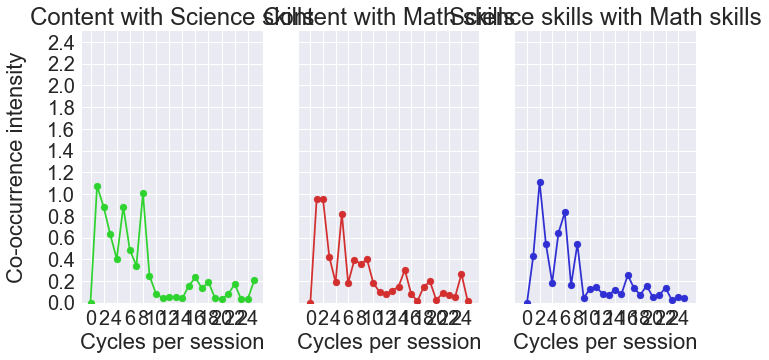

In [4086]:
f, axarr  = plt.subplots(1, 3, sharey=True)
plt.sca(axarr[0])
axarr[0].set_ylim(0,2.5)
avg1 = np.mean(super_vectors_corpus_splitted[doc]['c-s'])
# Number of sample points
N = len(super_vectors_corpus_splitted[doc]['c-s'])
# sample spacing
T = 1.0 / N
x = np.linspace(0.0, N*T, N)
yf = fft(super_vectors_corpus_splitted[doc]['c-s']-avg1)
xf = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
axarr[0].scatter(xf,2.0/N * np.abs(yf[0:N//2]),c=axes_colors[0])
axarr[0].plot(xf, 2.0/N * np.abs(yf[0:N//2]),c=axes_colors[0])
axarr[0].set_title('Content with Science skills')
plt.grid(True)
plt.ylabel('Co-occurrence intensity', labelpad=20)
plt.xlabel('Cycles per session')
plt.xticks(np.arange(0,N//2,2))
plt.yticks(np.arange(0,2.5,0.25))


plt.sca(axarr[1])
#t2 = np.arange(60)#
axarr[0].set_ylim(0,2.5)
avg2 = np.mean(super_vectors_corpus_splitted[doc]['c-m'])
yf2 = fft(super_vectors_corpus_splitted[doc]['c-m']-avg2)
xf2 = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
axarr[1].plot(xf2,2.0/N * np.abs(yf2[0:N//2]),c=axes_colors[1])
axarr[1].scatter(xf2,2.0/N * np.abs(yf2[0:N//2]),c=axes_colors[1])
plt.xticks(np.arange(0,N//2,2))
plt.grid(True)
plt.xlabel('Cycles per session')
#plt.ylabel('Co-occurrence intensity')
axarr[1].set_title('Content with Math skills')
plt.yticks(np.arange(0,2.5,0.25))

plt.sca(axarr[2])
axarr[0].set_ylim(0,2.5)
#t3 = np.arange(60)#
avg3 = np.mean(super_vectors_corpus_splitted[doc]['s-m'])
yf3 = fft(super_vectors_corpus_splitted[doc]['s-m']-avg3)
xf3 = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
axarr[2].plot(xf3,2.0/N * np.abs(yf3[0:N//2]),c=axes_colors[2])
axarr[2].scatter(xf3,2.0/N * np.abs(yf3[0:N//2]),c=axes_colors[2])
plt.xticks(np.arange(0,N//2,2))
plt.yticks(np.arange(0,2.5,0.2))

plt.grid(True)
#plt.ylabel('Co-occurrence intensity')
plt.xlabel('Cycles per session')
axarr[2].set_title('Science skills with Math skills')
plt.show()

## Disaggregated topic analysis

### Top 10 topics combinations

In [4087]:
vector_ij = []
for i in range(len(selected_topics)):
    for j in range(len(selected_topics)):
        if j > i:
            vector_ij.append((i,j))
len(vector_ij)

120

In [4088]:
def get_triada_names_vector(triada):
    return [selected_topics[vector_ij[triada[0]][0]]+' - '+selected_topics[vector_ij[triada[0]][1]],\
            selected_topics[vector_ij[triada[1]][0]]+' - '+selected_topics[vector_ij[triada[1]][1]],\
            selected_topics[vector_ij[triada[2]][0]]+' - '+selected_topics[vector_ij[triada[2]][1]]]
            
def get_triadas_vector(i_j_k):
    return [vector_ij[i_j_k[0]],vector_ij[i_j_k[1]],vector_ij[i_j_k[2]]]

In [4089]:
def get_triada_names(triada):
    return [selected_topics[triada[0]]+' - '+selected_topics[triada[1]],\
            selected_topics[triada[0]]+' - '+selected_topics[triada[2]],\
            selected_topics[triada[1]]+' - '+selected_topics[triada[2]]]

def get_triadas(i_j_k):
    return [(i_j_k[0],i_j_k[1]),(i_j_k[0],i_j_k[2]),(i_j_k[1],i_j_k[2])]

In [4090]:
def get_time_series(a_triada):
    x = []
    y = []
    z = []
    for i in range(len(labels_by_session[doc].keys())):
        label_i = doc+'_period_'+str(i)
        #value_i = labels_array_matrices.index(label_i)
        a_matrix = norm_matrices[label_i]
        x.append(a_matrix[a_triada[0]])
        y.append(a_matrix[a_triada[1]])
        z.append(a_matrix[a_triada[2]])
    return x,y,z

In [4091]:
def get_time_series_n_pairs(a_list_of_pairs):
    n_series = []
    for pair in a_list_of_pairs:
        pair_i = pair.split('-')[0]
        pair_j = pair.split('-')[1]
        i = selected_topics.index(pair_i)
        j = selected_topics.index(pair_j)
        aux_series = []
        for label in range(len(labels_by_session[doc].keys())):
            label_i = doc+'_period_'+str(label)
            a_matrix = norm_matrices[label_i]
            aux_series.append(a_matrix[i,j])
        n_series.append(aux_series)
    return n_series

In [4092]:
def get_time_series_n_pairs_clean(a_list_of_pairs):
    n_series = []
    for pair in a_list_of_pairs:
        i = pair[0]
        j = pair[1]
        aux_series = []
        for label in range(len(labels_by_session[doc].keys())):
            label_i = doc+'_period_'+str(label)
            a_matrix = norm_matrices[label_i]
            aux_series.append(a_matrix[i,j])
        n_series.append(aux_series)
    return n_series

In [4093]:
np.linspace(0.0, 20, 20,endpoint=False)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19.])

In [4094]:
def get_time_series_plot(x_y_z,x_y_z_names):
    #f, ax  = plt.figure()
    #plt.sca(axarr[0])
    #avg1 = np.mean(x_y_z[0])
    # Number of sample points
    N = len(x_y_z[0])
    # sample spacing
    #T = 1.0 / N
    xf = np.linspace(0.0, N, N,endpoint=False)
    plt.plot(xf,x_y_z[0],c="#ffa135",label=x_y_z_names[0])
    plt.plot(xf,x_y_z[1],c="#ab35ff",label=x_y_z_names[1])
    plt.plot(xf,x_y_z[2],c="#35e7ff",label=x_y_z_names[2])
    plt.scatter(xf,x_y_z[0],c="#ffa135")
    plt.scatter(xf,x_y_z[1],c="#ab35ff")
    plt.scatter(xf,x_y_z[2],c="#35e7ff")
    #plt.legend( borderaxespad=0.)
    plt.ylim(0,2.5)
    plt.grid(True)
    plt.ylabel('Co-occurrence intensity',labelpad=20)
    plt.xlabel('5 minutes period (1 minute shift)')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.show()

In [4095]:
import random
def rgb2hex(color):
    string = '#'
    for value in color:
        hex_string = hex(value)  #  e.g. 0x7f
        reduced_hex_string = hex_string[2:]  # e.g. 7f
        capitalized_hex_string = reduced_hex_string.upper()  # e.g. 7F
        string += capitalized_hex_string  # e.g. #7F7F7F
    return string

def colors(n):
    ret = []
    r = int(random.random() * 256)
    g = int(random.random() * 256)
    b = int(random.random() * 256)
    step = 256 / n
    for i in range(n):
        r += step
        g += step
        b += step
        r = int(r) % 256
        g = int(g) % 256
        b = int(b) % 256
        ret.append(rgb2hex((r,g,b)) )
    return ret
import seaborn as sns
palette = sns.color_palette(None, 3)

In [4096]:
palette

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804)]

In [4097]:
def get_time_series_plot_n_pairs(a_list,names):
    # Number of sample points
    N = len(a_list[0])
    colors_n =  sns.color_palette(None, len(a_list))
    for i,an_element in enumerate(a_list):
        xf = np.linspace(0.0, N, N,endpoint=False)
        plt.plot(xf,a_list[i],c=colors_n[i],label=names[i])
        plt.scatter(xf,a_list[i],c=colors_n[i])
    plt.legend(borderaxespad=0.)
    plt.set_ylim(0,2)
    plt.grid(True)
    plt.ylabel('Co-occurrence intensity')
    plt.xlabel('5 minutes period (1 minute shift)')
    #plt.xticks(np.arange(0,N//2,2))
    plt.show()

In [4098]:
def get_time_series_interactive(a_list,names):
    N = len(a_list[0])
    colors_n =  sns.color_palette(None,len(a_list))
    data = []
    for i,an_element in enumerate(a_list):
        rangel = range(N)
        a_trace = go.Scatter(
            x= rangel,
            y=an_element,
            name = names[i],
            marker = dict(size=10,opacity=0.8),
            #line = dict(color = colors_n[i]),
            opacity = 0.8)

        data.append(a_trace)

    layout = dict(
        title="Co-occurrence intensity of the main pair of topics <br>"+ dict_labels_english[doc],
        legend = dict(traceorder='normal'),
        xaxis=dict(title='5 minutes period (1 minute shift)'),
        yaxis=dict(title='Co-occurrence intensity',range=[0, 2.5])
    )

    fig = go.Figure(data=data, layout=layout)
    offline.init_notebook_mode()
    offline.iplot(fig, filename='Time series2-'+str(doc)+'.html')

In [4099]:
def get_fourier_plot(x_y_z,x_y_z_names):
    f, axarr  = plt.subplots(1, 3, sharey=True)
    axarr[0].set_ylim(0,0.9)
    plt.sca(axarr[0])
    avg1 = np.mean(x_y_z[0])
    # Number of sample points
    N = len(x_y_z[0])
    # sample spacing
    T = 1.0 / N
    yf = fft(x_y_z[0]-avg1)
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
    axarr[0].scatter(xf,2.0/N * np.abs(yf[0:N//2]),c="#ffa135")
    axarr[0].plot(xf, 2.0/N * np.abs(yf[0:N//2]),c="#ffa135")
    axarr[0].set_title(x_y_z_names[0])
    plt.grid(True)
    plt.ylabel('Co-occurrence intensity', labelpad=20)
    plt.xlabel('Cycles per session')
    #plt.xticks(np.arange(0,N//2,2))

    plt.sca(axarr[1])
    #t2 = np.arange(60)#
    avg2 = np.mean(x_y_z[1])
    yf2 = fft(x_y_z[1]-avg2)
    xf2 = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
    axarr[1].plot(xf2,2.0/N * np.abs(yf2[0:N//2]),c="#ab35ff")
    axarr[1].scatter(xf2,2.0/N * np.abs(yf2[0:N//2]),c="#ab35ff")
    #plt.xticks(np.arange(0,N//2,2))
    plt.grid(True)
    plt.xlabel('Cycles per session')
    #plt.ylabel('Co-occurrence intensity')
    axarr[1].set_title(x_y_z_names[1])

    plt.sca(axarr[2])
    #t3 = np.arange(60)#
    avg3 = np.mean(x_y_z[2])
    yf3 = fft(x_y_z[2]-avg3)
    xf3 = np.linspace(0.0, 1.0/(2.0*T), N//2,endpoint=False)
    axarr[2].plot(xf3,2.0/N * np.abs(yf3[0:N//2]),c="#35e7ff")
    axarr[2].scatter(xf3,2.0/N * np.abs(yf3[0:N//2]),c="#35e7ff")
    #plt.xticks(np.arange(0,N//2,2))
    plt.grid(True)
    #plt.ylabel('Co-occurrence intensity')
    plt.xlabel('Cycles per session')
    axarr[2].set_title(x_y_z_names[2])
    plt.show()

In [4100]:
x_3d = []
y_3d = []
z_3d = []
las_labels = []
for i in range(len(labels_by_session[doc].keys())):
    # construir label_i
    label_i = doc+'_period_'+str(i)
    #value_i = labels_array_matrices.index(label_i)
    a_label = splitted_labels[label_i]
    x_3d.append(round(super_vectors[label_i][2],2)*12)
    y_3d.append(round(super_vectors[label_i][1],2)*12)
    z_3d.append(round(super_vectors[label_i][0],2)*12)
    le_str = axes_text[0]+': '+str(round(super_vectors[label_i][0],2)*12)+'<br>'+\
    axes_text[1]+': '+str(round(super_vectors[label_i][1],2)*12)+'<br>'+\
    axes_text[2]+': '+str((round(super_vectors[label_i][2],2)*12))+'<br>'+labels_by_session[doc][label_i]
    las_labels.append(le_str)

In [4101]:
def get_trayectory(x_y_z,x_y_z_names):
    trace1 = go.Scatter3d(
        x=x_y_z[0],
        y=x_y_z[1],
        z=x_y_z[2],
        showlegend=False,
        line=dict(
            #color='#D32F2F',
            width=2.8
        ),
        hoverinfo = 'text',
        marker=dict(
            color=range(len(labels_by_session[doc].keys())),   
            colorscale='RdBu',# set color to an array/list of desired values
            opacity=0
        )
    )
    #title="Trajectory "+ str(dict_labels_english[doc]),
    data = [trace1,trace_dummy]
    layout = go.Layout(
        title = "Co-occurrence intensity of main pairs of topics <br>"+dict_labels_english[doc],
        scene = dict(
            zaxis = dict(title = x_y_z_names[2],backgroundcolor="#f5f5e9",
                         titlefont=dict(size=14,color="#35e7ff"),gridcolor="#8a8a78",showbackground=True),
            yaxis = dict(title = x_y_z_names[1],backgroundcolor="#ededd8",
                            titlefont=dict(size=14,color="#ab35ff"),gridcolor="#8a8a78",showbackground=True),
            xaxis = dict(title = x_y_z_names[0],backgroundcolor="rgb(230, 230,200)",
                            titlefont=dict(size=14,color="#ffa135"),gridcolor="#8a8a78",showbackground=True)
        )
    )
    fig = go.Figure(data=data, layout=layout)
    #py.iplot(fig, filename='3d-scatter-colorscale')
    offline.init_notebook_mode()
    offline.iplot(fig, filename='3d-scatter-colorscale-'+str(doc))

In [4102]:
def get_not_repeated_pairs(a_list):
    a_dict = {}
    for a_triad in a_list:
        for a_pair in a_triad:
            a,b = a_pair.split('-')
            a = str.rstrip(a)
            b = str.strip(b)
            a_key = a+"-"+b
            b_key = b+"-"+a
            if a_key in a_dict or b_key in a_dict:
                continue
            else:
                a_dict[a_key] = a_key
    return a_dict.values()

## Get ranking of the main pair of topics

In [4103]:
pylab.rcParams['figure.figsize'] = (13,9)

In [4104]:
# Encontrar 10 triadas mejores
count = 0
an_array = []
an_array_index = []
for i in range(len(selected_topics)):
    for j in range(len(selected_topics)):
        if j>i:
            count += 1
            an_array_index.append((i,j))
            an_array.append(norm_matrices_corpus[doc][i,j])
print count
an_array = np.array(an_array)
an_array_index = np.array(an_array_index)

120


In [4105]:
n_triadas = 10
ind = np.argpartition(an_array, -n_triadas)[-n_triadas:]
top_n = an_array[ind]
ind_sort = np.argsort(top_n)
triadas_names = map(lambda x: (selected_topics[x[0]],selected_topics[x[1]]),an_array_index[ind[ind_sort]])
top_n = top_n[ind_sort]
for i in range(n_triadas):
    print str(i+1)+'- '+"; \t".join(triadas_names[-(i+1)])+ ';  \t'+str(round(top_n[-(i+1)],2))

1- Electrostatics; 	Dynamics;  	0.57
2- Explain; 	Enquire;  	0.55
3- Enquire; 	Dynamics;  	0.48
4- Electric circuits; 	Electrostatics;  	0.48
5- Compute; 	Enquire;  	0.43
6- Electrostatics; 	Enquire;  	0.41
7- Electric circuits; 	Forms of energy;  	0.4
8- Electric circuits; 	Compute;  	0.36
9- Electrostatics; 	Compute;  	0.35
10- Electric circuits; 	Dynamics;  	0.34


In [4106]:
all_pairs = top_n
get_time_series_interactive(get_time_series_n_pairs_clean(an_array_index[ind[ind_sort]]),map(lambda x: x[0]+'-'+x[1],triadas_names))

#### Note: The figure above doesn't maintain the color code between sessions, as the color code will depend on the top-10 topic pairs of each session

## Another ranking

In [4107]:
# Encontrar 10 triadas mejores
count = 0
an_array = []
an_array_index = []
for i in range(len(selected_topics)):
    for j in range(len(selected_topics)):
        for k in range(len(selected_topics)):
            if j>i and k>i and k>j:
                count += 1
                an_array_index.append((i,j,k))
                an_array.append(norm_matrices_corpus[doc][i,j]+norm_matrices_corpus[doc][i,k]+norm_matrices_corpus[doc][j,k])
print count
an_array = np.array(an_array)
an_array_index = np.array(an_array_index)

560


In [4108]:
n_triadas = 10
ind = np.argpartition(an_array, -n_triadas)[-n_triadas:]
top_n = an_array[ind]
ind_sort = np.argsort(top_n)
triadas_names = map(lambda x: get_triada_names(x),an_array_index[ind[ind_sort]])
triadas =  map(lambda x: get_triadas(x),an_array_index[ind[ind_sort]])
top_n = top_n[ind_sort]
for i in range(n_triadas):
    print str(i+1)+'- '+"; \t".join(triadas_names[-(i+1)])+ ';  \t'+str(round(top_n[-(i+1)],2))

1- Electrostatics - Enquire; 	Electrostatics - Dynamics; 	Enquire - Dynamics;  	1.46
2- Electric circuits - Electrostatics; 	Electric circuits - Dynamics; 	Electrostatics - Dynamics;  	1.39
3- Explain - Enquire; 	Explain - Dynamics; 	Enquire - Dynamics;  	1.32
4- Electrostatics - Compute; 	Electrostatics - Dynamics; 	Compute - Dynamics;  	1.26
5- Explain - Compute; 	Explain - Enquire; 	Compute - Enquire;  	1.26
6- Compute - Enquire; 	Compute - Dynamics; 	Enquire - Dynamics;  	1.26
7- Electric circuits - Electrostatics; 	Electric circuits - Enquire; 	Electrostatics - Enquire;  	1.22
8- Explain - Electrostatics; 	Explain - Enquire; 	Electrostatics - Enquire;  	1.21
9- Kinematics - Electrostatics; 	Kinematics - Dynamics; 	Electrostatics - Dynamics;  	1.21
10- Electric circuits - Electrostatics; 	Electric circuits - Forms of energy; 	Electrostatics - Forms of energy;  	1.2


## Plot the main triad

The following figure shows the three pair of topics that together sum the highest cumulative co-occurrence.

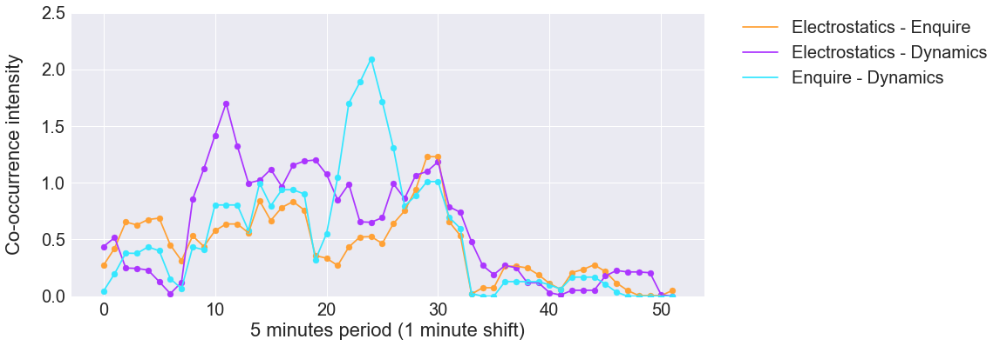

In [4109]:
pylab.rcParams['figure.figsize'] = (13,6)
mpld3.disable_notebook()
get_time_series_plot(get_time_series(triadas[-1]),triadas_names[-1])

### Co-occurrence intensity by cycles per session 

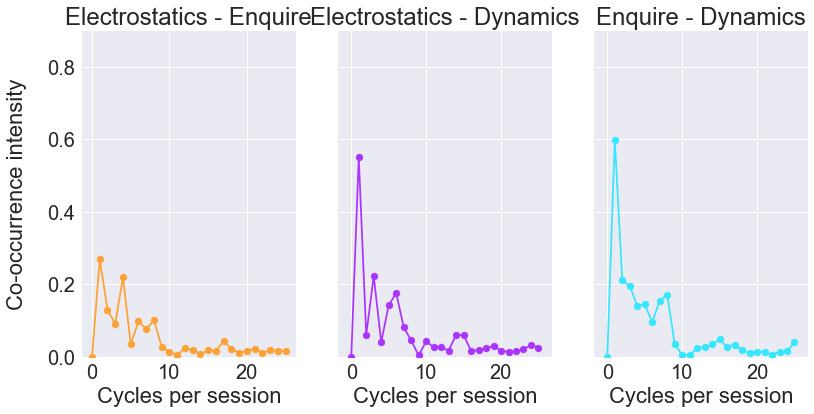

In [4110]:
get_fourier_plot(get_time_series(triadas[-1]),triadas_names[-1])

In [4111]:
trace_dummy = go.Scatter3d(
                x= [0,1],
                y=[0,1],
                z = [0,1],
                line = dict(color = axes_colors[0]),
                opacity = 0.0,
                showlegend=False)

### Trayectory of a session (bluest dot is the beginning, redest dot is the ending)

In [4112]:
get_trayectory(get_time_series(triadas[-1]),triadas_names[-1])

## Summary of the co-occurrence intensity in the whole session

In [4113]:
import seaborn as sns

In [4114]:
super_topics_colors = axes_colors #science, #physics, #math

colors_by_topic = {}
for i in range(len(content_topics)):
    colors_by_topic[selected_topics[content_topics[i]]] = super_topics_colors[1]
for i in range(len(science_skills_topics)):
    colors_by_topic[selected_topics[science_skills_topics[i]]] = super_topics_colors[0]
for i in range(len(science_tools_topics)):
    colors_by_topic[selected_topics[science_tools_topics[i]]] = super_topics_colors[2]

In [4115]:
def sort_a_matrix(a_matrix,sorted_index):
    new_matrix = np.zeros((len(sorted_index),len(sorted_index)))
    for i in range(len(sorted_index)):
        for j in range(len(sorted_index)):
            new_matrix[i,j] = a_matrix[sorted_index[i],sorted_index[j]]
    return new_matrix

In [4116]:
sorted_names_topics

array(['Kinematics', 'Dynamics', 'Gas laws', 'Solar system',
       'Water resources', 'Forms of energy', 'Electric circuits',
       'Electrostatics', 'Observe', 'Enquire', 'Explain', 'Excercise',
       'Time units', 'Compute', 'Numbers', 'Order'], dtype='|S17')

In [4117]:
pylab.rcParams['figure.figsize'] = (12,9)

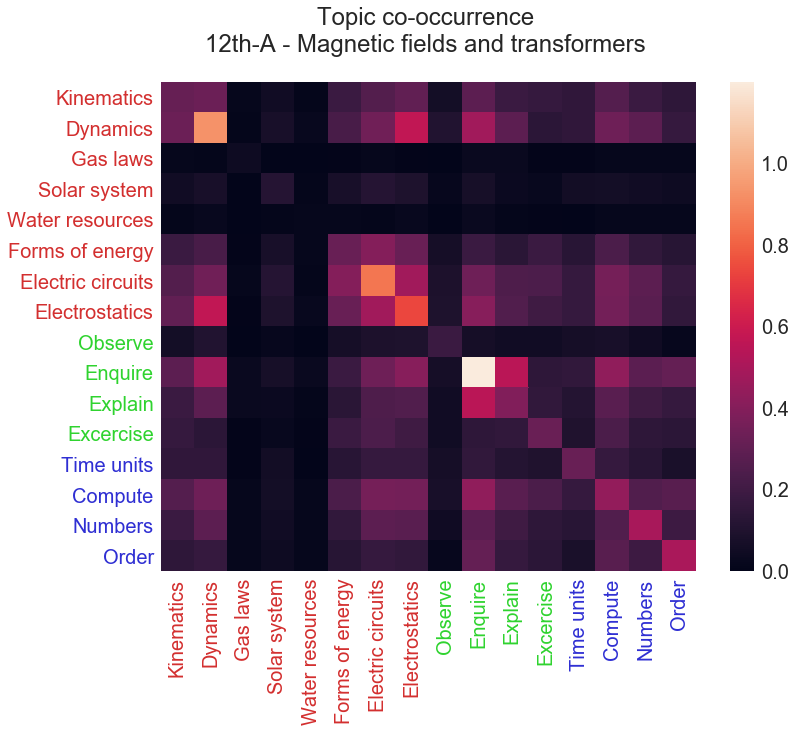

In [4127]:
mpld3.disable_notebook()
a_label = dict_labels_english[doc]
directory = os.path.join('heatmap',str.rstrip(a_label))
if not os.path.exists(directory):
    os.makedirs(directory)
a_matrix = norm_matrices_corpus[doc]
sorted_topics = content_topics + science_skills_topics + science_tools_topics
sorted_names_topics = np.array(selected_topics)[sorted_topics]
for k in range(len(a_matrix)):
    for j in range(len(a_matrix)):
        if k>j:
            a_matrix[k,j] = a_matrix[j,k]
df = pd.DataFrame(sort_a_matrix(a_matrix,sorted_topics))
#df.columns = sorted_names_topics #['physics','science','math']
#df.index =  sorted_names_topics #['physics','science','math']
#print len(sorted_names_topics)

gotcha = sns.set(font_scale=2.0)
ax_sn = sns.heatmap(df,xticklabels=sorted_names_topics, yticklabels=sorted_names_topics)
gotcha = ax_sn.set_title(u"Topic co-occurrence \n"+a_label,y=1.05)    
for tick_label in ax_sn.axes.get_yticklabels():
    tick_text = tick_label.get_text()
    tick_label.set_color(colors_by_topic[tick_text])
for tick_label in ax_sn.axes.get_xticklabels():
    tick_text = tick_label.get_text()
    tick_label.set_color(colors_by_topic[tick_text])
figure = ax_sn.get_figure()  
#figure.savefig(os.path.join(directory,label_i+".png"), bbox_inches='tight')
#filesnames.append(os.path.join(directory,label_i+".png"))
figure.savefig(os.path.join(directory,a_label+".png"), bbox_inches='tight')

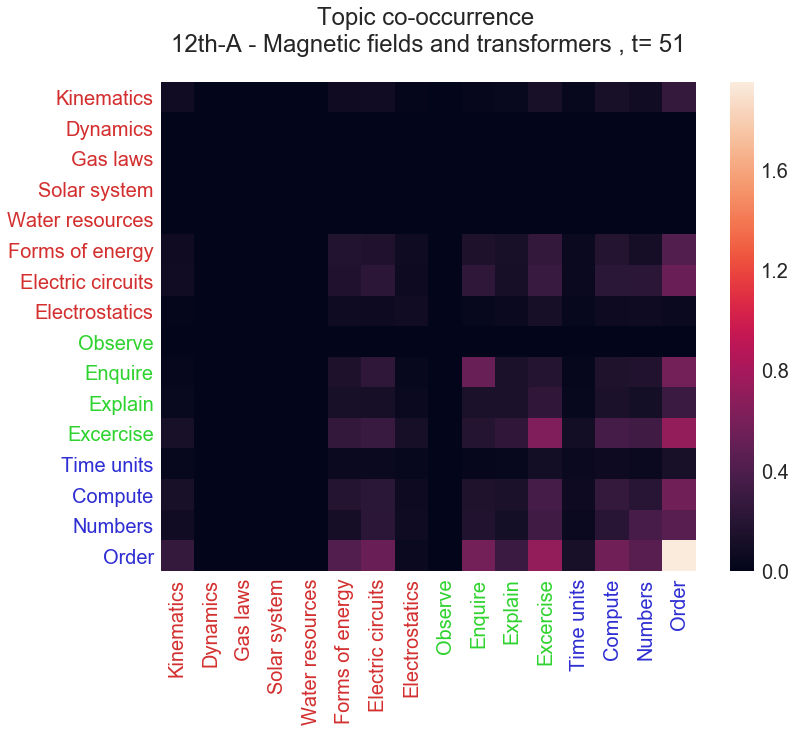

In [4128]:
les_df = []
a_label = dict_labels_english[doc]
filesnames = []
sorted_topics = content_topics + science_skills_topics + science_tools_topics
sorted_names_topics = np.array(selected_topics)[sorted_topics]
for i in range(len(labels_by_session[doc].keys())):
    # construir label_i
    label_i =  doc+'_period_'+str(i)
    a_matrix = norm_matrices[label_i]
    for k in range(len(a_matrix)):
        for j in range(len(a_matrix)):
            if k>j:
                a_matrix[k,j] = a_matrix[j,k]
    df = pd.DataFrame(sort_a_matrix(a_matrix,sorted_topics))
    df.columns = sorted_names_topics#['physics','science','math']
    df.index =  sorted_names_topics#['physics','science','math']
    # df = 
    les_df.append(df)
    if i ==0:
        cbar =True
    else:
        cbar = False
    sns.set(font_scale=2.0)
    ax_sn = sns.heatmap(df,vmin=0,cbar=cbar,) 
    ax_sn.set_title(u"Topic co-occurrence \n"+a_label+", t= "+str(i),y=1.05)    
    for tick_label in ax_sn.axes.get_yticklabels():
        tick_text = tick_label.get_text()
        tick_label.set_color(colors_by_topic[tick_text])
    for tick_label in ax_sn.axes.get_xticklabels():
        tick_text = tick_label.get_text()
        tick_label.set_color(colors_by_topic[tick_text])
    figure = ax_sn.get_figure()  
    figure.savefig(os.path.join(directory,label_i+".png"), bbox_inches='tight')
    filesnames.append(os.path.join(directory,label_i+".png"))

In [4129]:
import imageio

In [4130]:
images = []
for filename in filesnames:
    images.append(imageio.imread(filename))
kargs = { 'duration': 0.5 }
imageio.mimsave('heatmap/'+a_label+'.gif', images,**kargs)

In [4132]:
from IPython.display import HTML
HTML('<img src="'+'heatmap/'+a_label+'2.gif'+'">')